In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objs as go

from tqdm import tqdm
from glob import glob
from collections import Counter
from plotly.offline import iplot
from IPython.core.interactiveshell import InteractiveShell

from fbprophet import Prophet
import statsmodels.api as sm

InteractiveShell.ast_node_interactivity = 'all'
%matplotlib inline

In [6]:
df = pd.read_csv('./data/training.csv')
# df.date = pd.to_datetime(df.date)
# df = df.set_index('date')
df.head(5)

,date,PM2.5|mean,PM2.5|median,PM2.5|std,PM2.5|min,PM2.5|max,temperature|mean,temperature|median,temperature|std,temperature|min,...,solarradiation|min,solarradiation|max,day_of_week,Year,Month,Day,Hour,day_of_year,quarter,week_of_year
0,2016-03-03 15:00:00,62.9,62.9,0.0,62.9,62.9,28.366667,28.30,0.208167,28.2,...,0.0,0.0,Thursday,2016,3,3,15,63,1,9
1,2016-03-03 16:00:00,62.9,62.9,0.0,62.9,62.9,28.000000,28.00,0.081650,27.9,...,0.0,0.0,Thursday,2016,3,3,16,63,1,9
2,2016-03-03 17:00:00,55.5,55.5,0.0,55.5,55.5,27.700000,27.70,0.081650,27.6,...,0.0,0.0,Thursday,2016,3,3,17,63,1,9
3,2016-03-03 18:00:00,55.5,55.5,0.0,55.5,55.5,27.433333,27.40,0.057735,27.4,...,0.0,0.0,Thursday,2016,3,3,18,63,1,9
4,2016-03-03 19:00:00,47.9,47.9,0.0,47.9,47.9,27.250000,27.25,0.057735,27.2,...,0.0,0.0,Thursday,2016,3,3,19,63,1,9


In [7]:
training = pd.DataFrame()
training['ds'] = df.date
training['y'] = df['PM2.5|mean']
training.head()

,ds,y
0,2016-03-03 15:00:00,62.9
1,2016-03-03 16:00:00,62.9
2,2016-03-03 17:00:00,55.5
3,2016-03-03 18:00:00,55.5
4,2016-03-03 19:00:00,47.9


In [8]:
model = Prophet()
model.fit(training)

/Users/nutorbit/.pyenv/versions/miniconda3-4.3.30/lib/python3.6/site-packages/pystan/misc.py:399: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.



In [9]:
future = model.make_future_dataframe(periods=100)
forecast = model.predict(future)

ValueError: Length of passed values is 21826, index implies 34

In [ ]:
_ = model.plot(forecast)

In [ ]:
_ = plt.plot(forecast['ds'], forecast['yhat'])

In [ ]:
_ = model.plot_components(forecast)


In [ ]:
sns.lmplot('pressure|mean', 'PM2.5|mean', df)

In [ ]:
sns.lmplot('temperature|mean', 'PM2.5|mean', df)

# Hypothesis Testing

In [10]:
X = df['pressure|mean']
X = sm.add_constant(X)

y = df['PM2.5|mean']

model = sm.OLS(y, X)

In [11]:
res = model.fit()

In [12]:
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             PM2.5|mean   R-squared:                       0.146
Model:                            OLS   Adj. R-squared:                  0.146
Method:                 Least Squares   F-statistic:                     3708.
Date:                Sun, 05 May 2019   Prob (F-statistic):               0.00
Time:                        21:09:57   Log-Likelihood:                -86547.
No. Observations:               21726   AIC:                         1.731e+05
Df Residuals:                   21724   BIC:                         1.731e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const         -1770.0103     29.484    -60.034      0.000   -1827.800   -1712.220
pressure|mean     1.7822      0.029     60.895      0.000       1.725       1.840
==============================================================================
Omnibus:                     5885.843   Durbin-Watson:                   0.148
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            16486.629
Skew:                           1.436   Prob(JB):                         0.00
Kurtosis:                       6.157   Cond. No.                     3.37e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 3.37e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

# Cross-Correlation

In [13]:
from pylab import rcParams
rcParams['figure.figsize'] = 18, 8

max correlation is at lag 59


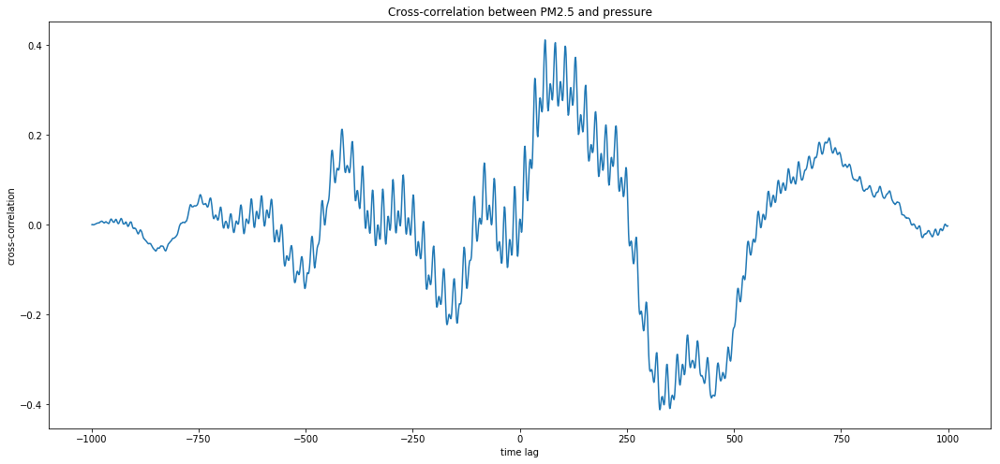

In [14]:
npts = 1000
x = np.linspace(0, 50, npts)
y1 = df['pressure|mean'].values[:npts]
y2 = df['PM2.5|mean'].values[:npts]

lags = np.arange(-npts + 1, npts)
ccov = np.correlate(y1 - y1.mean(), y2 - y2.mean(), mode='full')
ccor = ccov / (npts * y1.std() * y2.std())

fig, ax = plt.subplots(nrows=1)
_ = ax.plot(lags, ccor)
_ = ax.set_ylabel('cross-correlation')
_ = ax.set_xlabel('time lag')
_ = ax.set_title('Cross-correlation between PM2.5 and pressure')

maxlag = lags[np.argmax(ccor)]
print("max correlation is at lag %d" % maxlag)

# Auto-Correlation

In [15]:
def autocorr(x, twosided=False, tapered=True):
    """
    Return (lags, ac), where ac is the estimated autocorrelation 
    function for x, at the full set of possible lags.
    
    If twosided is True, all lags will be included;
    otherwise (default), only non-negative lags will be included.

    If tapered is True (default), the low-MSE estimate, linearly
    tapered to zero for large lags, is returned.
    """
    nx = len(x)
    xdm = x - x.mean()
    ac = np.correlate(xdm, xdm, mode='full')
    ac /= ac[nx - 1]
    lags = np.arange(-nx + 1, nx)
    if not tapered:  # undo the built-in taper
        taper = 1 - np.abs(lags) / float(nx)
        ac /= taper
    if twosided:
        return lags, ac
    else:
        return lags[nx-1:], ac[nx-1:]

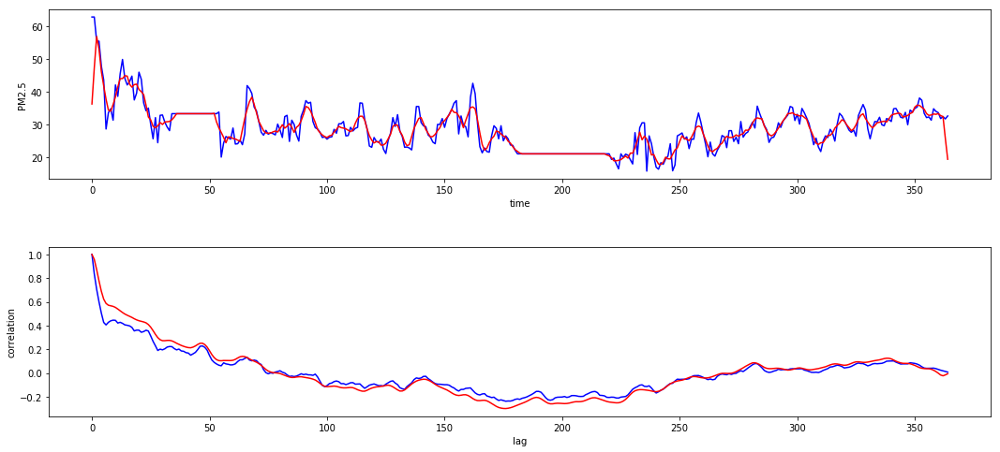

In [16]:
nx = 365
t = np.arange(nx)
x = df['PM2.5|mean'].values[:nx]
xc = np.convolve(x, np.ones(5) / 5.0, mode='same')

fig, (ax0, ax1) = plt.subplots(2)
fig.subplots_adjust(hspace=0.4)
_ = ax0.plot(t, x, 'b', t, xc, 'r')
_ = ax0.set_xlabel('time')
_ = ax0.set_ylabel('PM2.5')

lags, auto_x = autocorr(x)
lags, auto_xc = autocorr(xc)
_ = ax1.plot(lags, auto_x, 'b', lags, auto_xc, 'r')
_ = ax1.set_xlabel('lag')
_ = ax1.set_ylabel('correlation')

# for ax in (ax0, ax1):
#     ax.locator_params(axis='y', nbins=4)

# Classification

In [17]:
from xgboost import XGBClassifier, plot_importance
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report

In [18]:
df = df.set_index(df.date)
df = df.drop(['date'], axis=1)

bins = [0, 12, 35, 55, 150, 250, np.inf]
names = ['1', '2', '3', '4', '5', '6']

df['level'] = pd.cut(df['PM2.5|mean'], bins, labels=names).values
le = LabelEncoder()
df['day_of_week'] = le.fit_transform(df['day_of_week'])

In [19]:
model = XGBClassifier()

In [20]:
df.columns

Index(['PM2.5|mean', 'PM2.5|median', 'PM2.5|std', 'PM2.5|min', 'PM2.5|max',
       'temperature|mean', 'temperature|median', 'temperature|std',
       'temperature|min', 'temperature|max', 'dewpoint|mean',
       'dewpoint|median', 'dewpoint|std', 'dewpoint|min', 'dewpoint|max',
       'humidity|mean', 'humidity|median', 'humidity|std', 'humidity|min',
       'humidity|max', 'wind_speed|mean', 'wind_speed|median',
       'wind_speed|std', 'wind_speed|min', 'wind_speed|max', 'pressure|mean',
       'pressure|median', 'pressure|std', 'pressure|min', 'pressure|max',
       'precip_rate|mean', 'precip_rate|median', 'precip_rate|std',
       'precip_rate|min', 'precip_rate|max', 'precip_1hr|mean',
       'precip_1hr|median', 'precip_1hr|std', 'precip_1hr|min',
       'precip_1hr|max', 'solarradiation|mean', 'solarradiation|median',
       'solarradiation|std', 'solarradiation|min', 'solarradiation|max',
       'day_of_week', 'Year', 'Month', 'Day', 'Hour', 'day_of_year', 'quarter',
       '

In [21]:
X = df.drop(['level', 'PM2.5|mean', 'PM2.5|median', 'PM2.5|std', 'PM2.5|min', 'PM2.5|max'], axis=1)
y = df['level']

In [22]:
model.fit(X, y)

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='multi:softprob', random_state=0,
       reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
       silent=True, subsample=1)

In [23]:
pred = model.predict(X)
print(classification_report(y, pred))

              precision    recall  f1-score   support

           1       0.82      0.01      0.02      2629
           2       0.74      0.98      0.84     14728
           3       0.64      0.37      0.46      3436
           4       0.79      0.25      0.38       933

   micro avg       0.73      0.73      0.73     21726
   macro avg       0.75      0.40      0.43     21726
weighted avg       0.74      0.73      0.66     21726



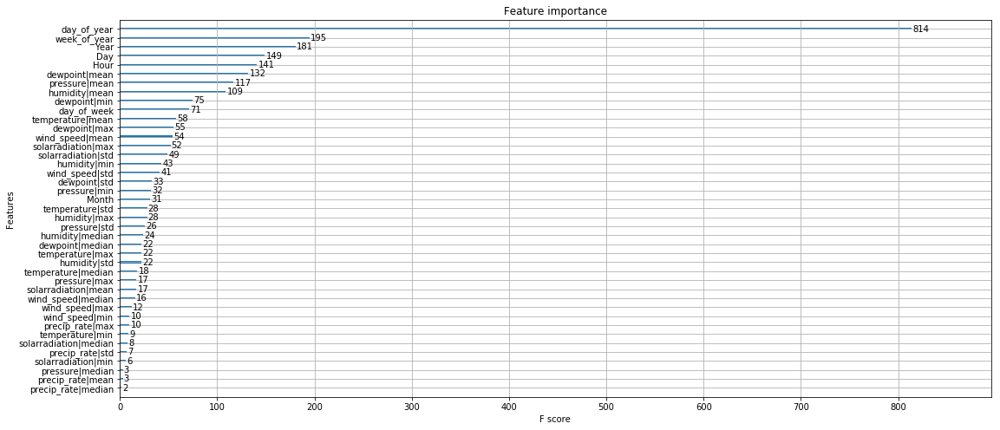

In [24]:
plot_importance(model)

# Regression Model

In [25]:
from xgboost import XGBRegressor

In [26]:
X = df.drop(['level', 'PM2.5|mean', 'PM2.5|median', 'PM2.5|std', 'PM2.5|min', 'PM2.5|max'], axis=1)
y = df['PM2.5|mean']

In [27]:
model = XGBRegressor()

In [28]:
model.fit(X, y)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=1, gamma=0, learning_rate=0.1, max_delta_step=0,
       max_depth=3, min_child_weight=1, missing=None, n_estimators=100,
       n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
       reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
       silent=True, subsample=1)

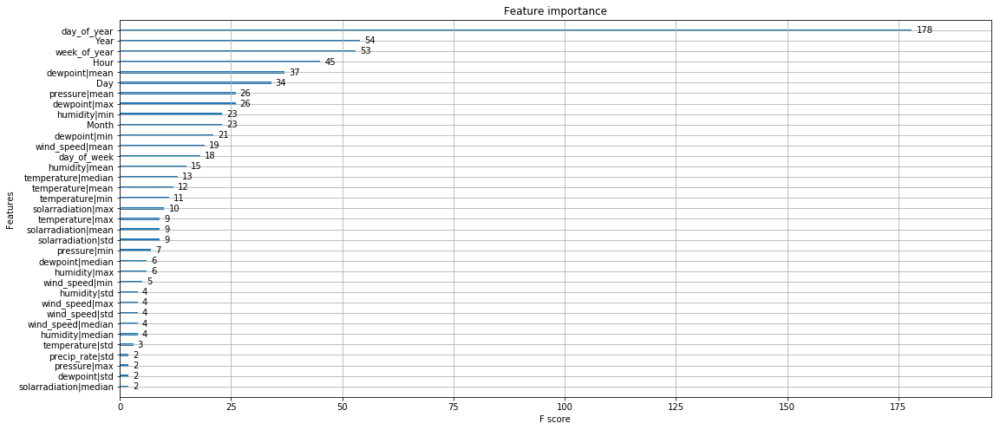

In [29]:
plot_importance(model)

In [30]:
pred = model.predict(X)

In [31]:
data = [
    go.Scatter(x=df.index, y=df['PM2.5|mean'], name='actual'),
    go.Scatter(x=df.index, y=pred, name='pred')
]

fig = go.Figure(data=data)
iplot(fig)

# LSTM

In [32]:
df.head()

,PM2.5|mean,PM2.5|median,PM2.5|std,PM2.5|min,PM2.5|max,temperature|mean,temperature|median,temperature|std,temperature|min,temperature|max,...,solarradiation|max,day_of_week,Year,Month,Day,Hour,day_of_year,quarter,week_of_year,level
date,,,,,,,,,,,,,,,,,,,,,
2016-03-03 15:00:00,62.9,62.9,0.0,62.9,62.9,28.366667,28.30,0.208167,28.2,28.6,...,0.0,4,2016,3,3,15,63,1,9,4
2016-03-03 16:00:00,62.9,62.9,0.0,62.9,62.9,28.000000,28.00,0.081650,27.9,28.1,...,0.0,4,2016,3,3,16,63,1,9,4
2016-03-03 17:00:00,55.5,55.5,0.0,55.5,55.5,27.700000,27.70,0.081650,27.6,27.8,...,0.0,4,2016,3,3,17,63,1,9,4
2016-03-03 18:00:00,55.5,55.5,0.0,55.5,55.5,27.433333,27.40,0.057735,27.4,27.5,...,0.0,4,2016,3,3,18,63,1,9,4
2016-03-03 19:00:00,47.9,47.9,0.0,47.9,47.9,27.250000,27.25,0.057735,27.2,27.3,...,0.0,4,2016,3,3,19,63,1,9,3


### Add Lag features

In [33]:
def prepare(df, y_label, lag=5):
    tmp = pd.DataFrame()
    for s in range(1, lag+1):
        for col in df.columns:
            tmp[col+f'(t-{s})'] = df[col].shift(s).fillna(method='bfill')
    tmp = pd.concat(
        [df[[y_label]], tmp],
        axis=1
    )
    return tmp

In [34]:
pre_df = prepare(df, 'PM2.5|mean')
pre_df = pre_df.astype(float)

In [35]:
cols = list(filter(lambda x: 'PM2.5|mean' in x, pre_df.columns))

In [37]:
data = []
idx = pre_df.index[-100:]

for col in cols[:]:
    data.append(
        go.Scatter(
            x=idx, y=pre_df.loc[idx, col], name=col
        )
    )

fig = go.Figure(data=data)
iplot(fig)

In [38]:
import tensorflow as tf
import tensorflow.keras.layers as kl

Limited tf.compat.v2.summary API due to missing TensorBoard installation
Limited tf.summary API due to missing TensorBoard installation


In [39]:
model = tf.keras.models.Sequential([
    kl.LSTM(126),
    kl.Dense(1)
])
model.compile(tf.optimizers.Adam(0.001), tf.losses.mean_absolute_error, ['mse'])

In [40]:
X = pre_df.drop('PM2.5|mean', axis=1).values
X = X.reshape(X.shape[0], X.shape[1], 1)
y = pre_df[['PM2.5|mean']].values

In [41]:
X.shape
y.shape

(21726, 270, 1)

(21726, 1)

In [64]:
model.fit(X, y, epochs=1, batch_size=32)

21726/21726 [==============================] - 128s 6ms/sample - loss: 7.1958 - mse: 102.8400


In [65]:
pred = model.predict(X)

In [57]:
data = [
    go.Scatter(x=df.index, y=df['PM2.5|mean'], name='actual'),
    go.Scatter(x=df.index, y=pred.ravel(), name='pred')
]

fig = go.Figure(data=data)
iplot(fig)

In [60]:
data = [
    go.Scatter(x=df.index, y=df['PM2.5|mean'], name='actual'),
    go.Scatter(x=df.index, y=pred.ravel(), name='pred')
]

fig = go.Figure(data=data)
iplot(fig)

In [63]:
data = [
    go.Scatter(x=df.index, y=df['PM2.5|mean'], name='actual'),
    go.Scatter(x=df.index, y=pred.ravel(), name='pred')
]

fig = go.Figure(data=data)
iplot(fig)

In [66]:
data = [
    go.Scatter(x=df.index, y=df['PM2.5|mean'], name='actual'),
    go.Scatter(x=df.index, y=pred.ravel(), name='pred')
]

fig = go.Figure(data=data)
iplot(fig)

# Moving average methods

In [70]:
tmp = pre_df[['PM2.5|mean']]

In [71]:
tmp.head()

,PM2.5|mean
date,
2016-03-03 15:00:00,62.9
2016-03-03 16:00:00,62.9
2016-03-03 17:00:00,55.5
2016-03-03 18:00:00,55.5
2016-03-03 19:00:00,47.9


In [99]:
def lst_ma(from_, to_, step_):
    lst = []
    for w in range(from_, to_, step_):
        ma = tmp.rolling(window=w).mean()
        ma.iloc[:w-1] = tmp.iloc[:w-1]
        lst.append(
            go.Scatter(x=df.index, y=ma['PM2.5|mean'], name=f'Window size {w}')
        )
    return lst

In [102]:
data = [
    go.Scatter(x=df.index, y=df['PM2.5|mean'], name='actual'),
]
data = data + lst_ma(100, 501, 100)

fig = go.Figure(data=data)
iplot(fig)

In [108]:
def lst_ema(from_, to_, step_):
    lst = []
    for w in range(from_, to_, step_):
        ma = tmp.ewm(span=w, adjust=False).mean()
#         ma.iloc[:w-1] = tmp.iloc[:w-1]
        lst.append(
            go.Scatter(x=df.index, y=ma['PM2.5|mean'], name=f'Window size {w}')
        )
    return lst

In [109]:
data = [
    go.Scatter(x=df.index, y=df['PM2.5|mean'], name='actual'),
]
data = data + lst_ma(100, 501, 100)

fig = go.Figure(data=data)
iplot(fig)